In [38]:
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 50  # limit in MB

In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np


In [22]:
# Set device to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [23]:
class VGGFeatures(nn.Module):
    def __init__(self, selected_layer=21):
        super(VGGFeatures, self).__init__()
        # Load the pretrained VGG19 model from torchvision
        self.vgg = models.vgg19(pretrained=True).features.to(device).eval()
        self.selected_layer = selected_layer
        
    def forward(self, x):
        # Pass the image through the layers until reaching conv4_1 (layer index 21)
        for i, layer in enumerate(self.vgg):
            x = layer(x)
            if i == self.selected_layer:
                return x

In [24]:
# Instantiate our feature extractor model
feature_extractor = VGGFeatures(selected_layer=21)

c:\Users\lenovo\anaconda3\envs\torchenv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to C:\Users\lenovo/.cache\torch\hub\checkpoints\vgg19-dcbb9e9d.pth
100.0%


In [25]:
# Define ImageNet normalization parameters
mean = [0.485, 0.456, 0.406]
std  = [0.229, 0.224, 0.225]

# Define preprocessing transform (resize, to tensor, normalize)
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

In [26]:
# Define a de-normalization function for visualization
def denormalize(tensor):
    # Clone the tensor to avoid modifying the original
    tensor = tensor.clone().detach().cpu()
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    # Clamp the values to [0, 1]
    tensor = torch.clamp(tensor, 0, 1)
    return tensor

# Function to load an image from file and preprocess it.
def load_image(image_path):
    image = Image.open(image_path).convert('RGB')
    image = preprocess(image).unsqueeze(0)  # add batch dimension
    return image.to(device)

In [52]:
original_image = load_image(r'Images\dog image.jpg')

# Create a Gaussian noise image with the same shape
noise_image = torch.randn_like(original_image, device=device, requires_grad=True)

In [53]:
with torch.no_grad():
    target_features = feature_extractor(original_image)

# Define Mean Squared Error (MSE) loss
mse_loss = nn.MSELoss()

In [54]:
# optimizer = optim.Adam([noise_image], lr=0.01)
# # optimizer = optim.LBFGS([noise_image])

# # Number of iterations
# num_iterations = 200

# # List to store intermediate results for animation
# result_images = []

In [55]:
# print("Starting optimization...")
# for i in range(num_iterations):
#     optimizer.zero_grad()
    
#     # Extract features from the noise image
#     noise_features = feature_extractor(noise_image)
    
#     # Compute the loss between the features (flattened automatically by MSELoss)
#     loss = mse_loss(noise_features, target_features)
    
#     # Backpropagation and optimization step
#     loss.backward()
#     optimizer.step()
    
#     # Optionally clip the noise image values (not necessary but sometimes used)
#     # noise_image.data.clamp_(-1.5, 1.5)
    
#     # Store the current noise image (denormalized for visualization)
#     if i % 5 == 0 or i == num_iterations - 1:
#         # Detach and denormalize the image
#         vis_img = denormalize(noise_image.squeeze(0))
#         # Convert to numpy array (CHW -> HWC)
#         result_images.append(np.transpose(vis_img.numpy(), (1, 2, 0)))
    
#     if (i+1) % 20 == 0:
#         print(f"Iteration {i+1}/{num_iterations}, Loss: {loss.item():.4f}")

# print("Optimization finished.")

In [56]:
optimizer = optim.LBFGS([noise_image], lr=1, max_iter=1, history_size=10)

num_iterations = 200
result_images = []  # to store intermediate images for animation

print("Starting LBFGS optimization...")
iteration = 0  # counter for display and storage

for i in range(num_iterations):
    def closure():
        optimizer.zero_grad()
        features_noise = feature_extractor(noise_image)
        loss = mse_loss(features_noise, target_features)
        loss.backward()
        return loss

    loss = optimizer.step(closure)
    
    # Store intermediate results every 5 iterations or on the final iteration.
    if i % 5 == 0 or i == num_iterations - 1:
        vis_img = denormalize(noise_image.squeeze(0))
        result_images.append(np.transpose(vis_img.numpy(), (1, 2, 0)))
    
    if (i+1) % 20 == 0:
        print(f"Iteration {i+1}/{num_iterations}, Loss: {loss.item():.4f}")

print("LBFGS Optimization finished.")


Starting LBFGS optimization...
Iteration 20/200, Loss: 15.1725
Iteration 40/200, Loss: 6.1855
Iteration 60/200, Loss: 3.8004
Iteration 80/200, Loss: 2.7312
Iteration 100/200, Loss: 2.1403
Iteration 120/200, Loss: 1.7458
Iteration 140/200, Loss: 1.4836
Iteration 160/200, Loss: 1.2950
Iteration 180/200, Loss: 1.1446
Iteration 200/200, Loss: 1.0341
LBFGS Optimization finished.


In [57]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(result_images[0])
ax.axis('off')
ax.set_title("Optimized Image Progression")

def update(frame):
    im.set_array(result_images[frame])
    ax.set_title(f"Iteration {frame*5}")
    return [im]

anim = FuncAnimation(fig, update, frames=len(result_images), interval=100, blit=True)
plt.close()  # prevent duplicate display in some environments

In [58]:
# To display the animation in the notebook:
from IPython.display import HTML
HTML(anim.to_jshtml())

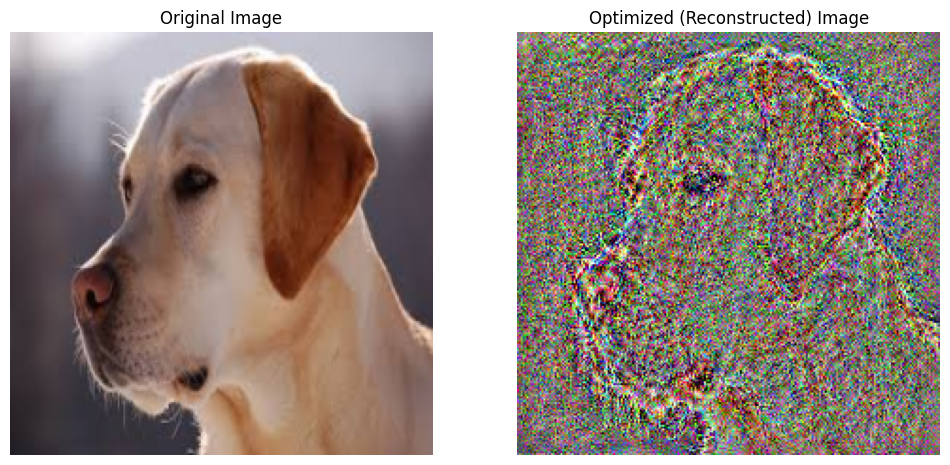

In [59]:
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
# Original image visualization
orig_vis = denormalize(original_image.squeeze(0))
axs[0].imshow(np.transpose(orig_vis.numpy(), (1, 2, 0)))
axs[0].set_title("Original Image")
axs[0].axis('off')
# Final optimized image visualization
final_vis = result_images[-1]
axs[1].imshow(final_vis)
axs[1].set_title("Optimized (Reconstructed) Image")
axs[1].axis('off')
plt.show()